# Your Title Here | Recipe's Avarage Rate Prediction

**Name(s)**: Risa Kuriyama

**Website Link**: (your website link)

In [444]:
import pandas as pd
import numpy as np
from pathlib import Path

import matplotlib.pyplot as plt
import plotly.express as px
pd.options.plotting.backend = 'plotly'

import plotly.graph_objects as go

from dsc80_utils import * # Feel free to uncomment and use this.

In [445]:
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True)

## Introduction

#### Hello

#### Using recipe data 👩‍🍳🍳
**1) Import each csv file and take a look at each content for analysis**
 - import raw interaction data (rows: 731927, columns: 5)
     - user_id(int): user id
     - recipe_id(int): recipe id
     - date(time): date that the recipe is reviewed (yyyy-mm-dd)
     - rating(int): rate of the recipe 0-5
     - review(str): review about the recipe

In [446]:
file_path_for_ri = '/Users/kuriyamarisa/Desktop/food_data/RAW_interactions.csv'
interactions = pd.read_csv(file_path_for_ri)
interactions

,user_id,recipe_id,date,rating,review
0,1293707,40893,2011-12-21,5,"So simple, so delicious! Great for chilly fall..."
1,126440,85009,2010-02-27,5,I made the Mexican topping and took it to bunk...
2,57222,85009,2011-10-01,5,"Made the cheddar bacon topping, adding a sprin..."
...,...,...,...,...,...
731924,157126,78003,2008-06-23,5,WOW! Sometimes I don't take the time to rate ...
731925,53932,78003,2009-01-11,4,Very good! I used regular port as well. The ...
731926,2001868099,78003,2017-12-18,5,I am so glad I googled and found this here. Th...


 - import raw recipes data (rows: 83782, columns: 12)
     - name(str): recipe name
     - id(int): recipe id
     - minutes(int): time to cook the recipe
     - contributor_id(int): contributor's id
     - submitted(date): date the recipe was submitted
     - tags(str list): Food.com tags for recipe
     - nutrition(str): list contains each nutrition's amount
     - n_steps(int): number of steps in recipe
     - steps(str list): steps to take in the recipe
     - description(str): description about the recipe
     - ingredients(str list): ingredients for the recipe
     - n_ingredients(int): the amount of ingredients

In [447]:
file_path_for_rr = '/Users/kuriyamarisa/Desktop/food_data/RAW_recipes.csv'
recipes = pd.read_csv(file_path_for_rr)
recipes

,name,id,minutes,contributor_id,...,steps,description,ingredients,n_ingredients
0,1 brownies in the world best ever,333281,40,985201,...,['heat the oven to 350f and arrange the rack i...,"these are the most; chocolatey, moist, rich, d...","['bittersweet chocolate', 'unsalted butter', '...",9
1,1 in canada chocolate chip cookies,453467,45,1848091,...,"['pre-heat oven the 350 degrees f', 'in a mixi...",this is the recipe that we use at my school ca...,"['white sugar', 'brown sugar', 'salt', 'margar...",11
2,412 broccoli casserole,306168,40,50969,...,"['preheat oven to 350 degrees', 'spray a 2 qua...",since there are already 411 recipes for brocco...,"['frozen broccoli cuts', 'cream of chicken sou...",9
...,...,...,...,...,...,...,...,...,...
83779,zydeco ya ya deviled eggs,308080,40,37779,...,"['in a bowl , combine the mashed yolks and may...","deviled eggs, cajun-style","['hard-cooked eggs', 'mayonnaise', 'dijon must...",8
83780,cookies by design cookies on a stick,298512,29,506822,...,['place melted butter in a large mixing bowl a...,"i've heard of the 'cookies by design' company,...","['butter', 'eagle brand condensed milk', 'ligh...",10
83781,cookies by design sugar shortbread cookies,298509,20,506822,...,"['whip sugar and shortening in a large bowl , ...","i've heard of the 'cookies by design' company,...","['granulated sugar', 'shortening', 'eggs', 'fl...",7


#### Q: How rating is going to change based on the features? 📈
- The columns I need:
    - rating - this is the main
    - minumtes, n_ingredients, steps, description, review 

 - 

## Data Cleaning and Exploratory Data Analysis
#### Data Cleaning
- clean data set:
    - merge both data sets with 'recipe_id' and 'id'
    - replace all nan value with 0 in rating column
    - calculate average rating as a Series and add it to the data set
    - put nutrition column's list element into each separated columns
    - drop unnecessary columns

In [448]:
# Left merge the recipes and interactions datasets
merged_data = recipes.merge(interactions, left_on="id", right_on="recipe_id", how="left")


# Replace all ratings of 0 with np.nan
merged_data['rating'] = merged_data['rating'].replace(0, np.nan)

# Calculate the average rating per recipe as a Series
avg_ratings = merged_data.groupby('recipe_id')['rating'].mean()

# Add the average rating back to the merged dataset
merged_data = merged_data.merge(avg_ratings, left_on="recipe_id", right_index=True, how="left", suffixes=('', '_avg'))
merged_data.rename(columns={"rating_avg": "avg_rating"}, inplace=True)


# Handle the nutrition column
# Convert nutrition column from string to list
merged_data['nutrition'] = merged_data['nutrition'].apply(lambda x: eval(x) if isinstance(x, str) else x)

# Create separate columns for each nutritional value
nutrition_cols = ['calories', 'total_fat', 'sugar', 'sodium', 'protein', 'saturated_fat', 'carbohydrates']
nutrition_data = pd.DataFrame(merged_data['nutrition'].tolist(), columns=nutrition_cols)
merged_data = pd.concat([merged_data, nutrition_data], axis=1)

# Drop unnecessary columns
merged_data = merged_data.drop(columns=['name','id', 'contributor_id', 'submitted', 'tags', 'steps', 'user_id', 'date','nutrition', 'recipe_id'], errors='ignore')

merged_data.head(10)


,minutes,n_steps,description,ingredients,...,sodium,protein,saturated_fat,carbohydrates
0,40,10,"these are the most; chocolatey, moist, rich, d...","['bittersweet chocolate', 'unsalted butter', '...",...,3.0,3.0,19.0,6.0
1,45,12,this is the recipe that we use at my school ca...,"['white sugar', 'brown sugar', 'salt', 'margar...",...,22.0,13.0,51.0,26.0
2,40,6,since there are already 411 recipes for brocco...,"['frozen broccoli cuts', 'cream of chicken sou...",...,32.0,22.0,36.0,3.0
...,...,...,...,...,...,...,...,...,...
7,90,17,"ready, set, cook! special edition contest entr...","['meatloaf mixture', 'unsmoked bacon', 'goat c...",...,12.0,29.0,48.0,2.0
8,90,17,"ready, set, cook! special edition contest entr...","['meatloaf mixture', 'unsmoked bacon', 'goat c...",...,12.0,29.0,48.0,2.0
9,20,5,costs about $5.00 to make.,"['ground beef', 'taco seasoning', 'taco shells...",...,6.0,39.0,39.0,0.0


#### Univariate Analysis
 - Plot1: Histgram for the number of ingredients
     - It shows the frequency of the number of ingredients in the data set. 7-8 ingredients are the most.
 - Plot2: Histgram for the rating of recipes
     - It shows the frequency of the rating. Rate 5 is the most in the data set.

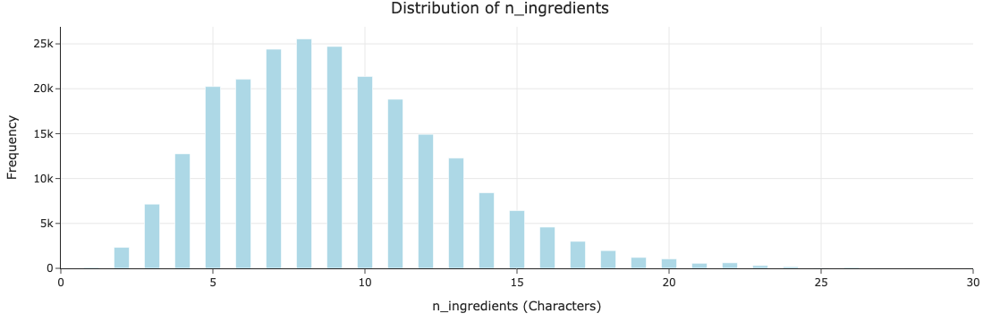

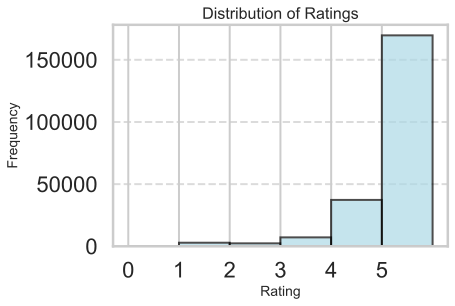

In [461]:
# Plot 1: Plotly Histogram for the Number of ingredients
fig = px.histogram(
    merged_data,
    x='n_ingredients',
    nbins=100,
    title='Distribution of n_ingredients',
    labels={'n_ingredients': 'n_ingredients (Characters)'},
    color_discrete_sequence=['lightblue']
)
fig.update_xaxes(range=[0,30])
fig.update_layout(
    xaxis_title='n_ingredients (Characters)',
    yaxis_title='Frequency',
    title_x=0.5
)
fig.show()



# Plot 2: Matplotlib Histogram for Ratings
plt.figure(figsize=(6, 4))
plt.hist(merged_data['rating'], bins=range(0,7), edgecolor='black', alpha=0.7, color='lightblue')
plt.title('Distribution of Ratings', fontsize=16)
plt.xlabel('Rating', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.xticks(range(0, 6))
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

In [450]:
merged_data

,minutes,n_steps,description,ingredients,...,sodium,protein,saturated_fat,carbohydrates
0,40,10,"these are the most; chocolatey, moist, rich, d...","['bittersweet chocolate', 'unsalted butter', '...",...,3.0,3.0,19.0,6.0
1,45,12,this is the recipe that we use at my school ca...,"['white sugar', 'brown sugar', 'salt', 'margar...",...,22.0,13.0,51.0,26.0
2,40,6,since there are already 411 recipes for brocco...,"['frozen broccoli cuts', 'cream of chicken sou...",...,32.0,22.0,36.0,3.0
...,...,...,...,...,...,...,...,...,...
234426,20,5,"i've heard of the 'cookies by design' company,...","['granulated sugar', 'shortening', 'eggs', 'fl...",...,4.0,4.0,11.0,6.0
234427,20,5,"i've heard of the 'cookies by design' company,...","['granulated sugar', 'shortening', 'eggs', 'fl...",...,4.0,4.0,11.0,6.0
234428,20,5,"i've heard of the 'cookies by design' company,...","['granulated sugar', 'shortening', 'eggs', 'fl...",...,4.0,4.0,11.0,6.0


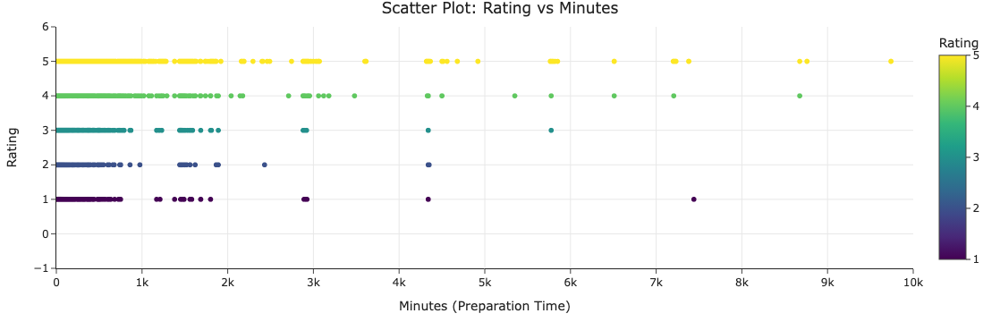

/var/folders/gs/vqfmsmb90451zylvjb1wsd_40000gn/T/ipykernel_51190/919746206.py:29: MatplotlibDeprecationWarning:

The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.



In [415]:
# MERGED DATA
# Scatter Plot: Rating vs Minutes (Plotly)
scatter_plot = px.scatter(
    merged_data,
    x='minutes',
    y='rating',
    title='Scatter Plot: Rating vs Minutes',
    labels={'minutes': 'Minutes (Preparation Time)', 'rating': 'Rating'},
    color='rating',  
    color_continuous_scale='Viridis'
)
scatter_plot.update_xaxes(range=[0, 10000])  
scatter_plot.update_yaxes(range=[-1, 6]) 
scatter_plot.update_layout(title_x=0.5)
scatter_plot.show()




# Box Plot: Rating vs Minutes (Binned) (Matplotlib)
# Create bins for preparation time
merged_data['minutes_binned'] = pd.cut(merged_data['minutes'], bins=[0, 15, 30, 60, 120], labels=['0-15', '15-30', '30-60', '60-120'])

# Group data by binned minutes
grouped_data = [merged_data[merged_data['minutes_binned'] == bin]['rating'].dropna() for bin in merged_data['minutes_binned'].cat.categories]

# Matplotlib Box Plot
plt.figure(figsize=(7, 5))
plt.boxplot(
    grouped_data,
    labels=merged_data['minutes_binned'].cat.categories,
    showmeans=True  # Show the mean as part of the box plot
)
plt.title('Box Plot: Rating vs Minutes (Binned)', fontsize=16)
plt.xlabel('Minutes (Preparation Time)', fontsize=14)
plt.ylabel('Rating', fontsize=14)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

#### Interesting Aggregates
 - Aggragate data
     - groupby the rate and shows average length of description and mitures to take for each rate
       - About description length, there is no specific pattern. Almost every rate has the similar length
       - About average minute, the longest minute has 0 rate and the 2nd longest minutes has 5 rate. For other rate, the average minutes are similar.
 - Pivot table
     - index is the minutes_bin and columns are the rate 0-5, and shows each average description length
       - Almost all minutes bins are the similar length of description, but 60-120min tends to have a little longer descriptions.
       

In [416]:
# create a new column - description length
merged_data['description_length'] = merged_data['description'].str.len().fillna(0).astype(int)

# Grouped Table: Aggregates by Rating
grouped_table = merged_data.groupby('rating').agg({
    'description_length': 'mean',  # mean length
    'minutes': 'mean'  # number of recipes
}).rename(columns={'description_length': 'avg_description_length', 'minutes': 'avg_minutes'})

# Pivot Table: Aggregates by Binned Minutes and Rating
pivot_table = merged_data.pivot_table(
    index='minutes_binned',
    columns='rating',
    values='description_length',
    aggfunc='mean'
)


print("Grouped Table:")
print(grouped_table)
print("")
print("Pivot Table:")
print(pivot_table)

Grouped Table:
        avg_description_length  avg_minutes
rating                                     
1.0                     265.13        99.67
2.0                     260.95        98.02
3.0                     237.56        87.50
4.0                     230.70        91.59
5.0                     248.38       106.92

Pivot Table:
rating             1.0     2.0     3.0     4.0     5.0
minutes_binned                                        
0-15            229.89  228.26  219.93  209.64  215.94
15-30           252.28  227.24  219.35  218.44  232.67
30-60           263.10  259.48  238.28  236.96  253.07
60-120          298.74  311.36  253.22  253.18  277.20


/var/folders/gs/vqfmsmb90451zylvjb1wsd_40000gn/T/ipykernel_51190/4157185019.py:11: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



## Assessment of Missingness

#### NMAR Analysis
- column [review] - not all people review for the recipe, regardless of how good it is (there are 57 missing)
- column [minutes_binned] - if the recipe takes more than 120min, it will be Nan (there are 24294 mmissing)

#### Missingness Dependency
Because of the amount of missingness, for [minutes binned], choose two columns for each
- column depends on other variable: minutes (p-value is 0.0)
    - reason: if the recipe takes long hours over the set bins, it will be missing values
- column doesn't depend on other variable: rating (p-value is 1.0)
    - reason: rating and time to take for preparation has no correlation. Rating might be strongly related to other factor.

In [394]:
merged_data.head(20)

,minutes,n_steps,description,ingredients,...,saturated_fat,carbohydrates,minutes_binned,description_length
0,40,10,"these are the most; chocolatey, moist, rich, d...","['bittersweet chocolate', 'unsalted butter', '...",...,19.0,6.0,30-60,260
1,45,12,this is the recipe that we use at my school ca...,"['white sugar', 'brown sugar', 'salt', 'margar...",...,51.0,26.0,30-60,230
2,40,6,since there are already 411 recipes for brocco...,"['frozen broccoli cuts', 'cream of chicken sou...",...,36.0,3.0,30-60,369
...,...,...,...,...,...,...,...,...,...
17,195,5,a hearty and comforting soup from the minnesot...,"['dried yellow peas', 'water', 'salt', 'pork',...",...,12.0,0.0,NaN,203
18,150,14,according to the site where i found this recip...,"['dried yellow peas', 'water', 'onions', 'clov...",...,0.0,2.0,NaN,275
19,50,13,spinach lightly sautéed in butter,"['fresh spinach', 'water', 'nutmeg', 'butter']",...,9.0,1.0,30-60,33


In [395]:
print(merged_data.isna().sum())

minutes                   0
n_steps                   0
description             114
                      ...  
carbohydrates             0
minutes_binned        24294
description_length        0
Length: 17, dtype: int64


#### For minute column (minutes_binned DOES depend on)

In [396]:
merged_data['missing_minutes_binned'] = merged_data['minutes_binned'].isna()
observed_stat = merged_data.groupby('missing_minutes_binned')['minutes'].mean().diff().iloc[-1]
print("Observed Test Statistic (Difference in Means):", observed_stat)

Observed Test Statistic (Difference in Means): 675.6750370116594


#### Permutation test

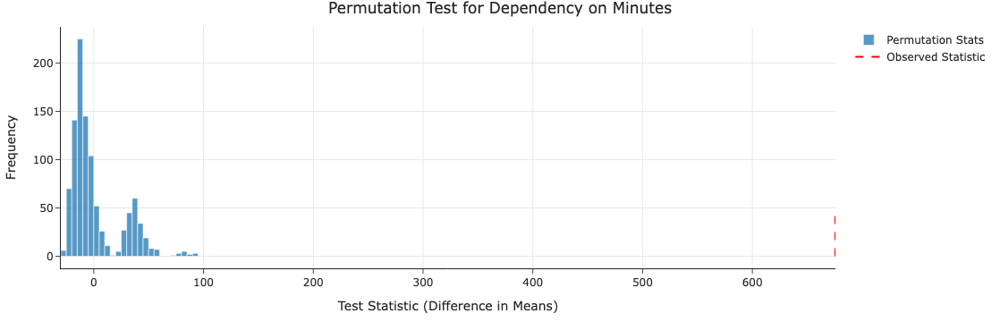

In [397]:
perm_stats = []

for _ in range(1000): 
    shuffled = merged_data['missing_minutes_binned'].sample(frac=1, replace=False).reset_index(drop=True)
    perm_stat = merged_data.groupby(shuffled)['minutes'].mean().diff().iloc[-1]
    perm_stats.append(perm_stat)

# Convert to NumPy array for plotting
perm_stats = np.array(perm_stats)


fig = go.Figure()

# Histogram of permuted statistics
fig.add_trace(go.Histogram(x=perm_stats, nbinsx=30, name='Permutation Stats', opacity=0.75))

# Observed statistic as a vertical line
fig.add_trace(go.Scatter(
    x=[observed_stat, observed_stat],
    y=[0, 50],  # Adjust y-range for clarity
    mode="lines",
    name="Observed Statistic",
    line=dict(color="red", dash="dash")
))

fig.update_layout(
    title="Permutation Test for Dependency on Minutes",
    xaxis_title="Test Statistic (Difference in Means)",
    yaxis_title="Frequency",
    showlegend=True
)

fig.show()


#### Result with p-value

In [398]:
p_value = (np.sum(perm_stats >= observed_stat)) / len(perm_stats)
print("P-value:", p_value)
print('Because of the p-value < 0.05, minute_binned is depending on minute')

P-value: 0.0
Because of the p-value < 0.05, minute_binned is depending on minute


#### For rating column (minutes_binned DOES NOT depend on)

In [399]:
observed_stat = merged_data.groupby('missing_minutes_binned')['rating'].mean().diff().iloc[-1]
print("Observed Test Statistic (Difference in Means):", observed_stat)

Observed Test Statistic (Difference in Means): -0.05722843088899143


#### Permutation test

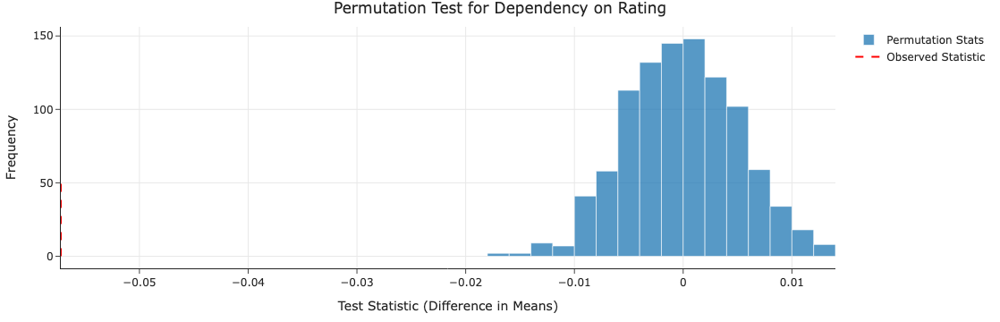

In [400]:
perm_stats = []

for _ in range(1000):  # Perform 1000 permutations
    shuffled = merged_data['missing_minutes_binned'].sample(frac=1, replace=False).reset_index(drop=True)
    perm_stat = merged_data.groupby(shuffled)['rating'].mean().diff().iloc[-1]
    perm_stats.append(perm_stat)

perm_stats = np.array(perm_stats)

fig = go.Figure()

# Histogram of permuted statistics
fig.add_trace(go.Histogram(x=perm_stats, nbinsx=30, name='Permutation Stats', opacity=0.75))

# Observed statistic as a vertical line
fig.add_trace(go.Scatter(
    x=[observed_stat, observed_stat],
    y=[0, 50],
    mode="lines",
    name="Observed Statistic",
    line=dict(color="red", dash="dash")
))

fig.update_layout(
    title="Permutation Test for Dependency on Rating",
    xaxis_title="Test Statistic (Difference in Means)",
    yaxis_title="Frequency",
    showlegend=True
)

fig.show()

#### Result with p-value

In [401]:
p_value = (np.sum(perm_stats >= observed_stat)) / len(perm_stats)
print("P-value:", p_value)
print('Because of the p-value > 0.05, minute_binned is NOT depending on rating')

P-value: 1.0
Because of the p-value > 0.05, minute_binned is NOT depending on rating


## Hypothesis Testing

### Q: Does the average rating differ significantly between recipes with short cooking times and long cooking times?
- H0: The average rating for both short and long preparation time for the recipes is the same.
- H1: The average rating for short and long preparation time for the recipe is different.

- Test statistic: Difference in rating means between the two groups (short time cooking and long time cooking)
- Significance level: 0.05 (5%)

- pvalue < 0.05 - regect H0. It means that the average rating for short and long preparation time for the recipe is different.

###Justify why these choices are good choices for answering the question you are trying to answer.


In [404]:
# Create two groups: short and long cooking times
short_cooking = merged_data[merged_data['minutes'] <= 30]['avg_rating'].dropna()
long_cooking = merged_data[merged_data['minutes'] > 30]['avg_rating'].dropna()

# Observed difference in means
observed_diff = short_cooking.mean() - long_cooking.mean()

# Combine the data
combined_ratings = np.concatenate([short_cooking, long_cooking])

# Permutation test
n_permutations = 5000
diffs = []

for _ in range(n_permutations):
    np.random.shuffle(combined_ratings)
    short_perm = combined_ratings[:len(short_cooking)]
    long_perm = combined_ratings[len(short_cooking):]
    diffs.append(short_perm.mean() - long_perm.mean())

# Calculate the p-value
p_value = (np.sum(np.abs(diffs) >= np.abs(observed_diff))) / n_permutations

print(f"Observed Difference: {observed_diff}")
print(f"P-Value: {p_value}")

Observed Difference: 0.03412279818560471
P-Value: 0.0


- pvalue < 0.05 - regect H0. It means that the average rating for short and long preparation time for the recipe is different. 

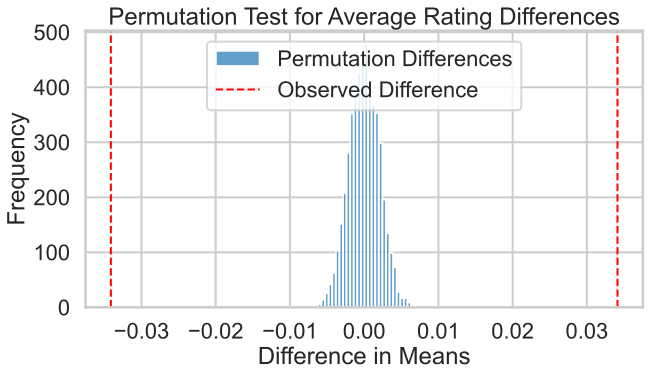

In [405]:
plt.hist(diffs, bins=30, alpha=0.7, label='Permutation Differences')
plt.axvline(observed_diff, color='red', linestyle='dashed', linewidth=2, label='Observed Difference')
plt.axvline(-observed_diff, color='red', linestyle='dashed', linewidth=2)
plt.title('Permutation Test for Average Rating Differences')
plt.xlabel('Difference in Means')
plt.ylabel('Frequency')
plt.legend()
plt.show()

## Framing a Prediction Problem

### Q: Predict average ratings of recipes 
    Which columns are the best for the features?
- Prediction type: regression (Linear Regression model)
- y (prediction value): rating
- X (features):
    - minutes - time to cook 
    - n_steps - the number of steps to cook
    - n_ingredients - the number of ingredients
    - nutritions - any specific nutrition (calories, sugar, sodium...etc)

### Justification
- About the time
    - All features need to be known before the rate is stated by the user.
    - User interaction data should be avoided for the feature such as review because this is stated after recipe is published.

## Baseline Model

### Model Description
- Type:
    - Linear Regression model
- Pipleline:
  - Scaler: StandardScaler was used to normalize the quantitative features, ensuring they are on the same scale
  - Regressor: LinearRegression to predict avg_rating
- Peformance:
    - RMSE: to see the accuracy of the prediction line with the error size

### Features
- Features (All Quantitative because of numerical): calories, total fat, and sugar
- Models: 20% for the test for unseen data, 80% for the training
    - Test data set: To see the unbiased estimate of how well the model gereralizes to new data
    - Training data set: To learn the relationship between the features and the target prediction value

In [443]:
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler

# relevant columns for the model
features = ['calories', 'total_fat', 'sugar']
target = 'avg_rating'

# drop rows with missing values in selected columns
modeling_data = merged_data[features + [target]].dropna()

# split the data into training and testing subsets
# 20% for the test for unseen data, 80% for the training
X = modeling_data[features]
y = modeling_data[target]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# create a pipeline with scaling and regression
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('regressor', LinearRegression())
])

# train the model
pipeline.fit(X_train, y_train)

# predict and evaluate
predictions = pipeline.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, predictions))

# shows the accuracy of the predictions
print(f"Root Mean Squared Error (RMSE): {rmse}")

Root Mean Squared Error (RMSE): 3.1401849173675503e-16


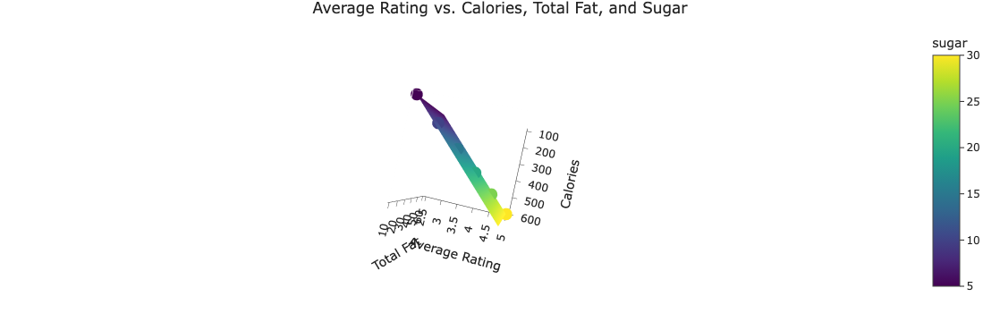

In [436]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from sklearn.linear_model import LinearRegression



# Fit Linear Regression Model
X = merged_data[['calories', 'total_fat', 'sugar']]
y = merged_data['avg_rating']
model = LinearRegression()
model.fit(X, y)

# Generate grid for regression plane
calories_range = np.linspace(merged_data['calories'].min(), merged_data['calories'].max(), 10)
total_fat_range = np.linspace(merged_data['total_fat'].min(), merged_data['total_fat'].max(), 10)
calories_grid, total_fat_grid = np.meshgrid(calories_range, total_fat_range)

# Use the mean of `sugar` for the regression plane
sugar_grid = np.full_like(calories_grid, merged_data['sugar'].mean())

# Flatten grids and predict
plane_pts = pd.DataFrame({
    'calories': calories_grid.ravel(),
    'total_fat': total_fat_grid.ravel(),
    'sugar': sugar_grid.ravel()
})
plane_pts['predicted'] = model.predict(plane_pts)

# Scatterplot with Regression Plane
fig = px.scatter_3d(
    merged_data,
    x='calories',
    y='total_fat',
    z='avg_rating',
    title="Average Rating vs. Calories, Total Fat, and Sugar",
    color='sugar'
)
fig.add_trace(go.Surface(
    x=calories_range,
    y=total_fat_range,
    z=plane_pts['predicted'].values.reshape(10, 10),
    colorscale="Viridis",
    name='Regression Plane',
    showscale=False
))
fig.update_layout(
    scene=dict(
        xaxis_title='Calories',
        yaxis_title='Total Fat',
        zaxis_title='Average Rating'
    )
)
fig.show()


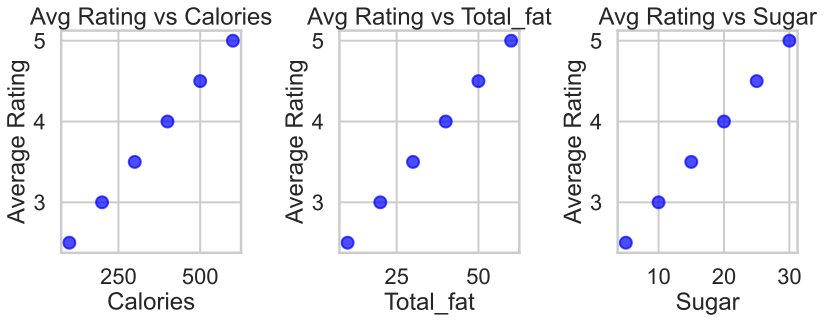

In [433]:
features = ['calories', 'total_fat', 'sugar']

# Create scatterplots for each feature
plt.figure(figsize=(12, 5))
for i, feature in enumerate(features):
    plt.subplot(1, 3, i + 1)
    plt.scatter(merged_data[feature], merged_data['avg_rating'], alpha=0.7, color='blue')
    plt.title(f'Avg Rating vs {feature.capitalize()}')
    plt.xlabel(feature.capitalize())
    plt.ylabel('Average Rating')
    plt.grid(True)

plt.tight_layout()
plt.show()

## Final Model

### Improvement
- Having different models for the pipeline:
    - StandardScaler: Standardizes numerical features by removing the mean and scaling to unit variance
        - Ensures all features are on the same scale
    - PolynomialFeatures: Generates additional features by computing interactions and powers of existing features (calories * sugar)
        - Capture the non-linear relation and it enhances the model flexibility and the prediciton accuracy.
    - QuantileTransformer: Transforms the data into a normal or uniform distribution.
        - Helps models handle skewed data better by normalizing feature distributions.
      
- Type:
    - RandomForestRegressor: To handle non-linear relation to have more accuracy.

- RMSE is a little bit improved from the previous 0.49 to 0.36
    - standardizes variance makes the prediction easier because all features are closer
    - captured the non-linear relation is crucial because linear regression is robust to the outliner

In [440]:
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler, QuantileTransformer, PolynomialFeatures
from sklearn.metrics import mean_squared_error

# Same steps from the previous baseline model

# relevant columns for the model
features = ['calories', 'total_fat', 'sugar']
target = 'avg_rating'

# drop rows with missing values in selected columns
modeling_data = merged_data[features + [target]].dropna()

# split the data into training and testing subsets
# 20% for the test for unseen data, 80% for the training
X = modeling_data[features]
y = modeling_data[target]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)




# Have a different model for the piple line

# Create a pipeline with other models from the previous step
# hyperparameters are randomForestRegressor
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('poly_features', PolynomialFeatures(degree=2, include_bias=False)),
    ('quantile_transform', QuantileTransformer(output_distribution='normal')),
    ('regressor', RandomForestRegressor(random_state=42))  # Default parameters
])

# Train the pipeline directly without 
pipeline.fit(X_train, y_train)

# Predict and evaluate
predictions = pipeline.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, predictions))

print(f"Root Mean Squared Error (RMSE): {rmse}")

/Users/kuriyamarisa/opt/anaconda3/envs/dsc80/lib/python3.12/site-packages/sklearn/preprocessing/_data.py:2785: UserWarning:

n_quantiles (1000) is greater than the total number of samples (4). n_quantiles is set to n_samples.



Root Mean Squared Error (RMSE): 1.0988175462741754


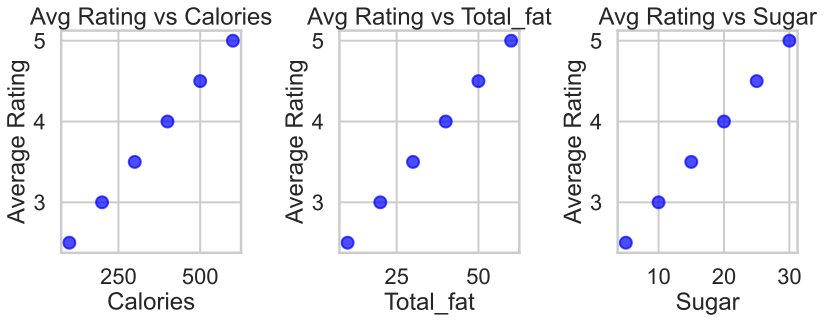

In [442]:
features = ['calories', 'total_fat', 'sugar']

# Create scatterplots for each feature
plt.figure(figsize=(12, 5))
for i, feature in enumerate(features):
    plt.subplot(1, 3, i + 1)
    plt.scatter(merged_data[feature], merged_data['avg_rating'], alpha=0.7, color='blue')
    plt.title(f'Avg Rating vs {feature.capitalize()}')
    plt.xlabel(feature.capitalize())
    plt.ylabel('Average Rating')
    plt.grid(True)

plt.tight_layout()
plt.show()

## Step 8: Fairness Analysis

- Check the fairness about each nutritions(high and low value) in the final model if the samples are fair to get the result of relation between the predict value. 

### Hypothesis
- H0: Our model is fair. Its precision for two groups (high and low), and any differences are due to random chance.
- H1: Our model is unfair. Its precision for two groups (high and low) and any differences are not random chance.

- Result
  - calories: samples are fair between the two groups
  - fat: samples are fair between the two groups
  - sugar: samples are unfair between the two groups. Prediction result might be affected depending on the sample.

In [459]:
# Define groups based on the median value of 'calories'
median_fat = X_test['total_fat'].median()
group_x = X_test[X_test['total_fat'] <= median_fat]
group_y = X_test[X_test['total_fat'] > median_fat]

# Get predictions for each group
predictions_x = pipeline.predict(group_x)
predictions_y = pipeline.predict(group_y)

# Calculate RMSE for each group
rmse_x = np.sqrt(mean_squared_error(y_test.loc[group_x.index], predictions_x))
rmse_y = np.sqrt(mean_squared_error(y_test.loc[group_y.index], predictions_y))

# Observed RMSE difference
observed_difference = abs(rmse_x - rmse_y)
print(f"Observed RMSE Difference: {observed_difference}")

# Permutation test
n_permutations = 1000
perm_differences = []

# Combine groups for permutation
combined_data = X_test.copy()
combined_data['group'] = np.where(combined_data['total_fat'] <= median_fat, 'X', 'Y')

for _ in range(n_permutations):
    # Shuffle group labels
    shuffled_labels = np.random.permutation(combined_data['group'])
    combined_data['shuffled_group'] = shuffled_labels

    # Split data into shuffled groups
    shuffled_x = combined_data[combined_data['shuffled_group'] == 'X']
    shuffled_y = combined_data[combined_data['shuffled_group'] == 'Y']

    # Compute RMSE for shuffled groups
    perm_predictions_x = pipeline.predict(shuffled_x[features])
    perm_predictions_y = pipeline.predict(shuffled_y[features])

    perm_rmse_x = np.sqrt(mean_squared_error(y_test.loc[shuffled_x.index], perm_predictions_x))
    perm_rmse_y = np.sqrt(mean_squared_error(y_test.loc[shuffled_y.index], perm_predictions_y))

    # Append absolute RMSE difference
    perm_differences.append(abs(perm_rmse_x - perm_rmse_y))

# Calculate p-value
p_value = np.mean([diff >= observed_difference for diff in perm_differences])
print(f"P-value: {p_value}")

# Interpretation
if p_value < 0.05:
    print("Reject the null hypothesis: The model's RMSE differs significantly between the two groups.")
else:
    print("Fail to reject the null hypothesis: No significant difference in RMSE between the two groups.")

Observed RMSE Difference: 0.006028626432783402
P-value: 0.473
Fail to reject the null hypothesis: No significant difference in RMSE between the two groups.


In [460]:
# Define groups based on the median value of 'calories'
median_sugar = X_test['sugar'].median()
group_x = X_test[X_test['sugar'] <= median_sugar]
group_y = X_test[X_test['sugar'] > median_sugar]

# Get predictions for each group
predictions_x = pipeline.predict(group_x)
predictions_y = pipeline.predict(group_y)

# Calculate RMSE for each group
rmse_x = np.sqrt(mean_squared_error(y_test.loc[group_x.index], predictions_x))
rmse_y = np.sqrt(mean_squared_error(y_test.loc[group_y.index], predictions_y))

# Observed RMSE difference
observed_difference = abs(rmse_x - rmse_y)
print(f"Observed RMSE Difference: {observed_difference}")

# Permutation test
n_permutations = 1000
perm_differences = []

# Combine groups for permutation
combined_data = X_test.copy()
combined_data['group'] = np.where(combined_data['sugar'] <= median_sugar, 'X', 'Y')

for _ in range(n_permutations):
    # Shuffle group labels
    shuffled_labels = np.random.permutation(combined_data['group'])
    combined_data['shuffled_group'] = shuffled_labels

    # Split data into shuffled groups
    shuffled_x = combined_data[combined_data['shuffled_group'] == 'X']
    shuffled_y = combined_data[combined_data['shuffled_group'] == 'Y']

    # Compute RMSE for shuffled groups
    perm_predictions_x = pipeline.predict(shuffled_x[features])
    perm_predictions_y = pipeline.predict(shuffled_y[features])

    perm_rmse_x = np.sqrt(mean_squared_error(y_test.loc[shuffled_x.index], perm_predictions_x))
    perm_rmse_y = np.sqrt(mean_squared_error(y_test.loc[shuffled_y.index], perm_predictions_y))

    # Append absolute RMSE difference
    perm_differences.append(abs(perm_rmse_x - perm_rmse_y))

# Calculate p-value
p_value = np.mean([diff >= observed_difference for diff in perm_differences])
print(f"P-value: {p_value}")

# Interpretation
if p_value < 0.05:
    print("Reject the null hypothesis: The model's RMSE differs significantly between the two groups.")
else:
    print("Fail to reject the null hypothesis: No significant difference in RMSE between the two groups.")

Observed RMSE Difference: 0.044365501569317234
P-value: 0.0
Reject the null hypothesis: The model's RMSE differs significantly between the two groups.
